# CrowdFunding compatible with Crowd benifits?
Kiva.org is an online crowdfunding platform to extend financial services to poor and financially excluded people around the world. Kiva lenders have provided over $1 billion dollars in loans to over 2 million people. In order to set investment priorities, help inform lenders, and understand their target communities, knowing the level of poverty of each borrower is critical.
* *Goal*: To estimate welfare level of borrower in specific region. To analyse MPI(Multidimensional Poverty Index) in different part of world.

***

**Steps** 
1. [Load pacakges](#Load-pacakges)
2. [Read data set](#Read-data-set)
3. [Glimpse data set](#Glimpse-data-set)
4. [Kiva Loans](#Kiva-Loans)
5. [Kiva MPI (Multidimensional Poverty Index)](#Kiva-MPI-(Multidimensional-Poverty-Index))
6. [Human Development Report](#HDI)

### Load required modules 
Let's load required modules for analysis

In [66]:
import pandas as pd  # Data analysis
import numpy as np #Data analysis
import seaborn as sns # Data visualization
import matplotlib.pyplot as plt # Data Visualization 
import  matplotlib.gridspec as gridspec # subplots and grid
from wordcloud import WordCloud, STOPWORDS # Visualize text

from IPython.display import HTML, display
import json
import folium # Map
import folium.plugins as plugins # Map
from mpl_toolkits.basemap import Basemap # Map

import warnings
warnings.filterwarnings('ignore')
import scipy.stats
import gc

# Plotting style and setting
plt.style.use('fivethirtyeight') #Plot style
#plt.style.use('bmh')
plt.rc('axes', labelsize=12) # plot setting
plt.rc('xtick', labelsize=12)
plt.rc('ytick', labelsize=12)
pd.options.display.max_rows = 100
% matplotlib inline

### Read data set
Read dataset using pandas

In [6]:
path = 'dataset/' # local file loaction
#path = '../input/data-science-for-good-kiva-crowdfunding/'
loan = pd.read_csv(path+'kiva_loans.csv')
mpi = pd.read_csv(path+'kiva_mpi_region_locations.csv')
#loan_theme = pd.read_csv(path+'loan_theme_ids.csv')
#loan_theme_region = pd.read_csv(path+'loan_themes_by_region.csv')

# MPI
#mpi_world = pd.read_csv('file/MPI_national.csv')
#mpi_subnational = pd.read_csv('file/MPI_subnational.csv')

#HDI
#path = '../input/human-development-index-hdi/'  
hdi = pd.read_csv(path+'HDI.csv')
continent_hdi = pd.read_csv(path+'Continent_HDI.csv')
geo_world_data = json.load(open(path+'countries.geojson'))

In [7]:
# Custom fuction for misssing value, data type, Unique value
def basic_details(df):
    print('Number of rows {} and columns {}'.format(df.shape[0],df.shape[1]))
    k = pd.DataFrame()
    k['dtype'] = df.dtypes
    k['Number of unique value'] = df.nunique()
    k['Missing value'] = df.isnull().sum()
    k['% missing value'] = df.isnull().sum()/df.shape[0]
    return k

### Glimpse data set
 Let's look at the few top row in the data set and also determine missing value, data type..

#### Kiva Loans

In [8]:
loan.head()

,id,funded_amount,loan_amount,activity,sector,use,country_code,country,region,currency,partner_id,posted_time,disbursed_time,funded_time,term_in_months,lender_count,tags,borrower_genders,repayment_interval,date
0,653051,300.0,300.0,Fruits & Vegetables,Food,"To buy seasonal, fresh fruits to sell.",PK,Pakistan,Lahore,PKR,247.0,2014-01-01 06:12:39+00:00,2013-12-17 08:00:00+00:00,2014-01-02 10:06:32+00:00,12.0,12,NaN,female,irregular,2014-01-01
1,653053,575.0,575.0,Rickshaw,Transportation,to repair and maintain the auto rickshaw used ...,PK,Pakistan,Lahore,PKR,247.0,2014-01-01 06:51:08+00:00,2013-12-17 08:00:00+00:00,2014-01-02 09:17:23+00:00,11.0,14,NaN,"female, female",irregular,2014-01-01
2,653068,150.0,150.0,Transportation,Transportation,To repair their old cycle-van and buy another ...,IN,India,Maynaguri,INR,334.0,2014-01-01 09:58:07+00:00,2013-12-17 08:00:00+00:00,2014-01-01 16:01:36+00:00,43.0,6,"user_favorite, user_favorite",female,bullet,2014-01-01
3,653063,200.0,200.0,Embroidery,Arts,to purchase an embroidery machine and a variet...,PK,Pakistan,Lahore,PKR,247.0,2014-01-01 08:03:11+00:00,2013-12-24 08:00:00+00:00,2014-01-01 13:00:00+00:00,11.0,8,NaN,female,irregular,2014-01-01
4,653084,400.0,400.0,Milk Sales,Food,to purchase one buffalo.,PK,Pakistan,Abdul Hakeem,PKR,245.0,2014-01-01 11:53:19+00:00,2013-12-17 08:00:00+00:00,2014-01-01 19:18:51+00:00,14.0,16,NaN,female,monthly,2014-01-01


In [9]:
loan.describe()

,id,funded_amount,loan_amount,partner_id,term_in_months,lender_count
count,6.712050e+05,671205.000000,671205.000000,657698.000000,671205.000000,671205.000000
mean,9.932486e+05,785.995061,842.397107,178.199616,13.739022,20.590922
std,1.966113e+05,1130.398941,1198.660073,94.247581,8.598919,28.459551
min,6.530470e+05,0.000000,25.000000,9.000000,1.000000,0.000000
25%,8.230720e+05,250.000000,275.000000,126.000000,8.000000,7.000000
50%,9.927800e+05,450.000000,500.000000,145.000000,13.000000,13.000000
75%,1.163653e+06,900.000000,1000.000000,204.000000,14.000000,24.000000
max,1.340339e+06,100000.000000,100000.000000,536.000000,158.000000,2986.000000


In [10]:
loan.describe(include=['O']) # Discribe categorical data

,activity,sector,use,country_code,country,region,currency,posted_time,disbursed_time,funded_time,tags,borrower_genders,repayment_interval,date
count,671205,671205,666973,671197,671205,614405,671205,671205,668809,622874,499789,666984,671205,671205
unique,163,15,424912,86,87,12695,67,667399,5719,498007,86719,11298,4,1298
top,Farming,Agriculture,to buy a water filter to provide safe drinking...,PH,Philippines,Kaduna,PHP,2017-05-15 00:00:00+00:00,2017-02-01 08:00:00+00:00,2016-09-21 13:03:24+00:00,user_favorite,female,monthly,2017-03-20
freq,72955,180302,5217,160441,160441,10000,160440,25,2800,33,27088,426502,342717,1308


In [11]:
# basic details
basic_details(loan).T

Number of rows 671205 and columns 20


,id,funded_amount,loan_amount,activity,sector,use,country_code,country,region,currency,partner_id,posted_time,disbursed_time,funded_time,term_in_months,lender_count,tags,borrower_genders,repayment_interval,date
dtype,int64,float64,float64,object,object,object,object,object,object,object,float64,object,object,object,float64,int64,object,object,object,object
Number of unique value,671205,610,479,163,15,424912,86,87,12695,67,366,667399,5719,498007,148,503,86719,11298,4,1298
Missing value,0,0,0,0,0,4232,8,0,56800,0,13507,0,2396,48331,0,0,171416,4221,0,0
% missing value,0,0,0,0,0,0.00630508,1.19189e-05,0,0.0846239,0,0.0201235,0,0.0035697,0.0720063,0,0,0.255385,0.00628869,0,0


The loan data set consist of 20 columns and 671205 rows. There are 5 numerical columns and 15 categorical columns.

### MPI
MPI (Multidimensional Poverty Index))

In [12]:
mpi.head()

,LocationName,ISO,country,region,world_region,MPI,geo,lat,lon
0,"Badakhshan, Afghanistan",AFG,Afghanistan,Badakhshan,South Asia,0.387,"(36.7347725, 70.81199529999999)",36.734772,70.811995
1,"Badghis, Afghanistan",AFG,Afghanistan,Badghis,South Asia,0.466,"(35.1671339, 63.7695384)",35.167134,63.769538
2,"Baghlan, Afghanistan",AFG,Afghanistan,Baghlan,South Asia,0.300,"(35.8042947, 69.2877535)",35.804295,69.287754
3,"Balkh, Afghanistan",AFG,Afghanistan,Balkh,South Asia,0.301,"(36.7550603, 66.8975372)",36.755060,66.897537
4,"Bamyan, Afghanistan",AFG,Afghanistan,Bamyan,South Asia,0.325,"(34.8100067, 67.8212104)",34.810007,67.821210


In [13]:
basic_details(mpi).T

Number of rows 2772 and columns 9


,LocationName,ISO,country,region,world_region,MPI,geo,lat,lon
dtype,object,object,object,object,object,float64,object,float64,float64
Number of unique value,984,102,102,928,6,452,881,880,787
Missing value,1788,1764,1764,1788,1764,1788,0,1880,1880
% missing value,0.645022,0.636364,0.636364,0.645022,0.636364,0.645022,0,0.678211,0.678211


In [14]:
mpi.describe(include=['O']) # Discribe categorical data

,LocationName,ISO,country,region,world_region,geo
count,984,1008,1008,984,1008,2772
unique,984,102,102,928,6,881
top,"Ogoouð-Lolo, Gabon",NGA,Nigeria,Central,Sub-Saharan Africa,"(1000.0, 1000.0)"
freq,1,37,37,8,432,1880


***
## Kiva Loans
Kiva.org is an online crowdfunding platform to extend financial services to poor and financially excluded people around the world.

#### Distribution of Fund amount
The distribution of funded amount given by the Kiva to borrowers.

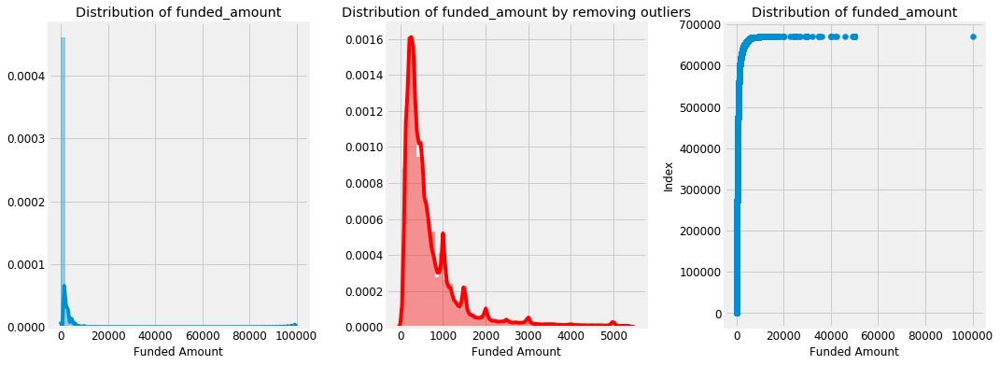

In [15]:
f,ax = plt.subplots(1,3,figsize=(16,6))
sns.distplot(loan['funded_amount'],ax=ax[0])
ax[0].set_title('Distribution of funded_amount')
ax[0].set_xlabel('Funded Amount')

ulimit = np.percentile(loan['funded_amount'],99)
llimit= np.percentile(loan['funded_amount'],1)
value = loan[(llimit<loan['funded_amount'])&(loan['funded_amount']<ulimit)]['funded_amount']
sns.distplot(value,color='r',ax=ax[1])
ax[1].set_title('Distribution of funded_amount by removing outliers');
ax[1].set_xlabel('Funded Amount')

ax[2].scatter(np.sort(loan['funded_amount'].values),range(loan.shape[0]),)
ax[2].set_title('Distribution of funded_amount');
ax[2].set_xlabel('Funded Amount')
ax[2].set_ylabel('Index')
plt.subplots_adjust(wspace=0.3)

> The funded amount is recieved by kiva.org by different people for the purpose of activity. The fund amount varies from 0 to 100k $USD$, fund is most concerntrated with in 2000 $USD$. 
In second plot oultier data is removed. These outlier data are 1st and 99th quatile/percentile. The percentile can computed using numpy module. The outliers in data set is remove, even after removal data is not normally distributed. 

### Distribution of Loan amount
The distribution of loan amount given by the Kiva to borrowers.

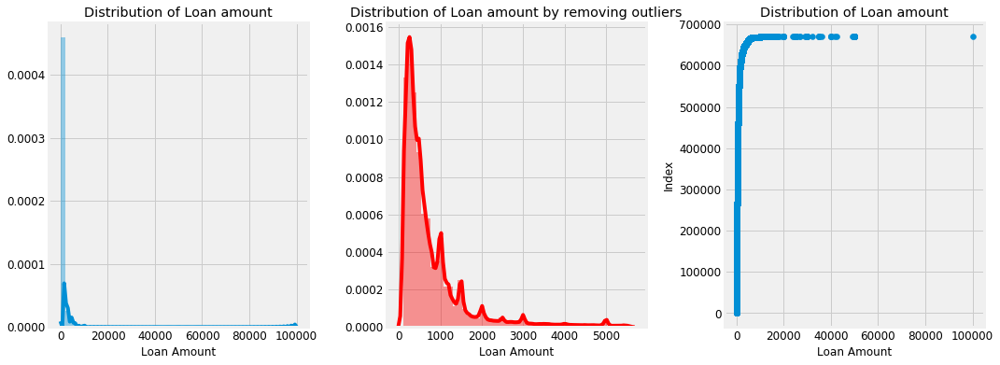

In [16]:
f,ax = plt.subplots(1,3,figsize=(16,6))
sns.distplot(loan['loan_amount'],ax=ax[0])
ax[0].set_title('Distribution of Loan amount')
ax[0].set_xlabel('Loan Amount')

ulimit = np.percentile(loan['loan_amount'],99)
llimit= np.percentile(loan['loan_amount'],1)
value = loan[(llimit<loan['loan_amount'])&(loan['loan_amount']<ulimit)]['loan_amount']
sns.distplot(value,color='r',ax=ax[1])
ax[1].set_xlabel('Loan Amount')
ax[1].set_title('Distribution of Loan amount by removing outliers');

ax[2].scatter(np.sort(loan['loan_amount'].values),range(loan.shape[0]),)
ax[2].set_title('Distribution of Loan amount');
ax[2].set_xlabel('Loan Amount')
ax[2].set_ylabel('Index')
plt.subplots_adjust(wspace=0.3)

> The loan amount varies from 0 to 100k $USD$, fund is most concerntrated with in 2000 $USD$. The outliers in data set is remove, even after removal data is not normal, data is right skewed. If we look at the third plot  is also not normally distributed

### Distribution of Listed country
Let's look at top recipent of loan by counties from kiva

In [17]:
m = folium.Map(location=[0,0],zoom_start=2)

poo = loan.groupby(['country_code']).agg({'count','count'})['id'].reset_index()

m.choropleth(geo_data= geo_world_data,
             data = poo, columns=['country_code','count'],key_on='feature.properties.wb_a2',name='Listed Country',
             fill_opacity=1,fill_color='YlOrBr',highlight=True, 
             threshold_scale=[100,1000,2000,4000,6000,10000],
            legend_name='Count')

folium.LayerControl().add_to(m)
m

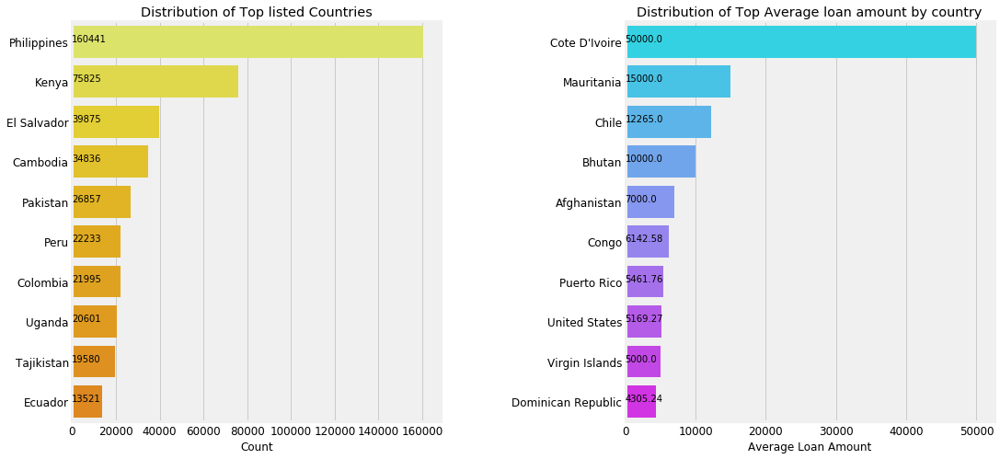

In [18]:
f,ax = plt.subplots(1,2,figsize=(16,8))
poo = loan['country'].value_counts()[:10]
sns.barplot(poo.values,poo.index, palette='Wistia', ax=ax[0])
ax[0].set_title('Distribution of Top listed Countries')
ax[0].set_xlabel('Count')

for i, v in enumerate(poo.values): 
            ax[0].text(.6,i, round(v,2),fontsize=10,color='k')
poo = loan.groupby('country').mean()['loan_amount'].sort_values(ascending=False)[:10]
sns.barplot(poo.values, poo.index, palette='cool', ax=ax[1])
ax[1].set_title('Distribution of Top Average loan amount by country')
ax[1].set_ylabel('')
ax[1].set_xlabel('Average Loan Amount')

for i, v in enumerate(poo.values): 
            ax[1].text(.6,i, round(v,2),fontsize=10,color='k')

plt.subplots_adjust(wspace=0.5);

* The Philippines followed Kenya are top recipent of loan
* The Cote D'Ivoire and Mauritania are top average loan
* If we look at the top listed country is different than average loan amount by country

**Let's look at boxplot of loan by country sorted Average amount ** 

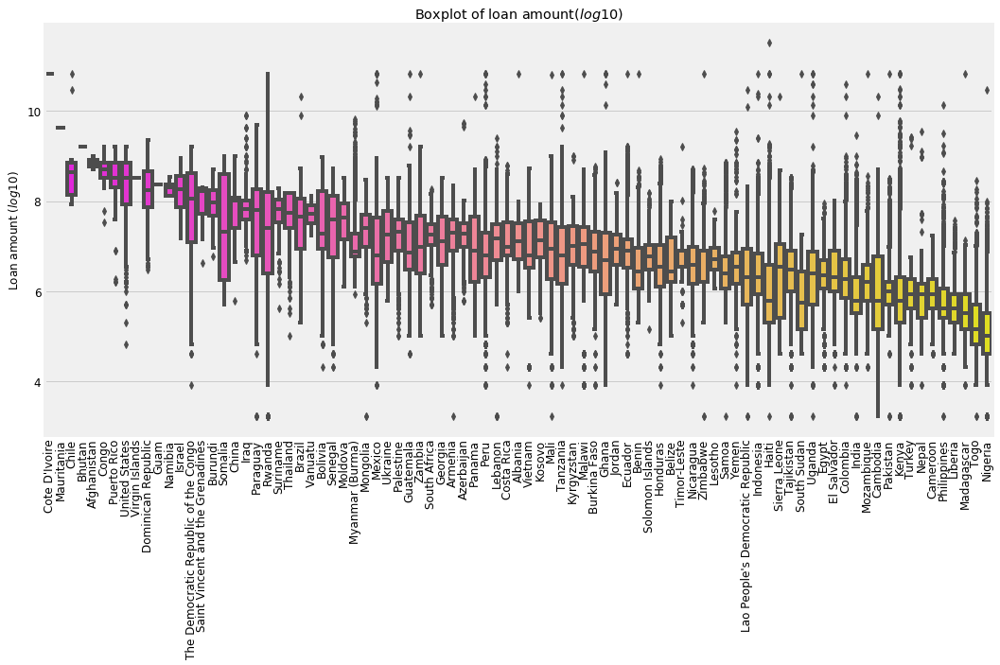

In [19]:
plt.figure(figsize=(16,8))

poo = loan.groupby('country').mean()['loan_amount'].sort_values(ascending=False)
sns.boxplot(loan['country'], np.log(loan['loan_amount']), palette='spring',order=poo.index)
plt.xlabel('')
plt.ylabel('Loan amount ($log10$)')
plt.title('Boxplot of loan amount($log10$)')
plt.xticks(rotation=90);

In [20]:
print("Cote D'Ivoire",loan[loan['country'] == "Cote D'Ivoire"]['loan_amount'])
print("Mauritania",loan[loan['country'] == "Mauritania"]['loan_amount'])

Cote D'Ivoire 631904    50000.0
Name: loan_amount, dtype: float64
Mauritania 38757    15000.0
Name: loan_amount, dtype: float64


* The Cote D'Ivoire and Mauritania are top average loan, but if look at the boxplot it look like both country have take loan only once.
* How both countries have taken very high loan? 

### Distribution of region
Let's look at the region to business utilise loan amount

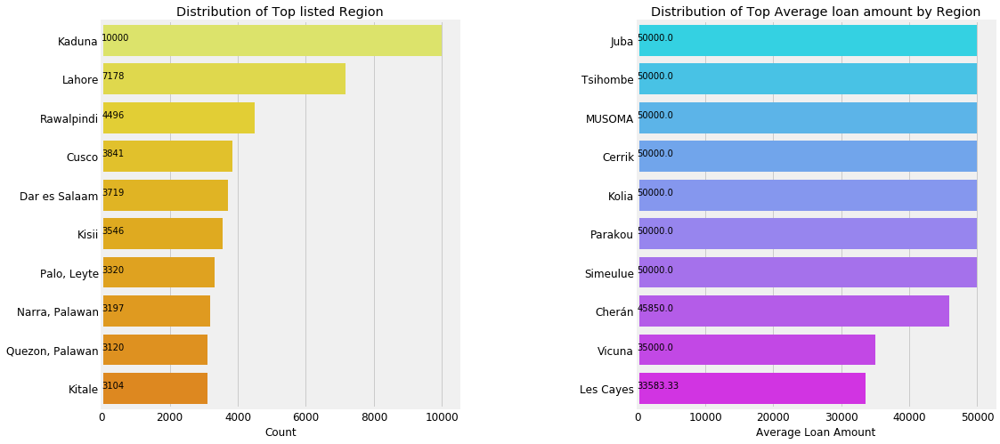

In [21]:
f,ax = plt.subplots(1,2,figsize=(16,8))
poo = loan['region'].value_counts()[:10]
sns.barplot(poo.values,poo.index, palette='Wistia', ax=ax[0])
ax[0].set_title('Distribution of Top listed Region')
ax[0].set_xlabel('Count')

for i, v in enumerate(poo.values): 
            ax[0].text(.6,i, round(v,2),fontsize=10,color='k')
poo = loan.groupby('region').mean()['loan_amount'].sort_values(ascending=False)[:10]
sns.barplot(poo.values, poo.index, palette='cool', ax=ax[1])
ax[1].set_title('Distribution of Top Average loan amount by Region')
ax[1].set_ylabel('')
ax[1].set_xlabel('Average Loan Amount')

for i, v in enumerate(poo.values): 
            ax[1].text(.6,i, round(v,2),fontsize=10,color='k')

plt.subplots_adjust(wspace=0.5);

### Distribution of sector
Let's look at the sector to business utilise loan amount

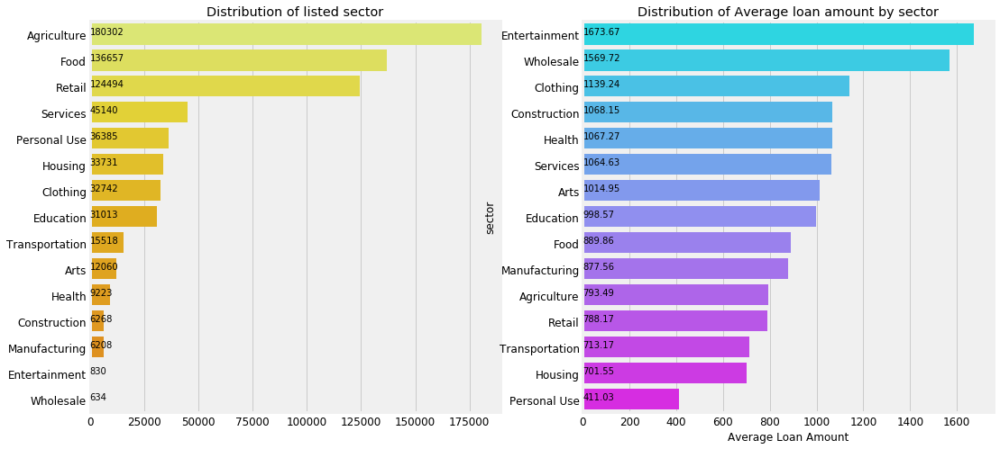

In [22]:
plt.figure( figsize =(16,8))
gridspec.GridSpec(2,2)

plt.subplot2grid((1,2),(0,0))
poo = loan['sector'].value_counts()
#plt.pie(poo.values, labels = poo.index, autopct='%1.1f%%',colors=sns.color_palette('Wistia'),startangle=60,)
sns.barplot(poo.values,poo.index,palette='Wistia')
for i, v in enumerate(poo.values): 
            plt.text(.6,i, round(v,2),fontsize=10,color='k')
plt.title('Distribution of listed sector')

plt.subplot2grid((1,2),(0,1))
poo = loan.groupby('sector').mean()['loan_amount'].sort_values(ascending=False)
sns.barplot(poo.values,poo.index,palette='cool')
plt.title('Distribution of Average loan amount by sector')
plt.xlabel('Average Loan Amount')
for i, v in enumerate(poo.values): 
            plt.text(.6,i, round(v,2),fontsize=10,color='k')


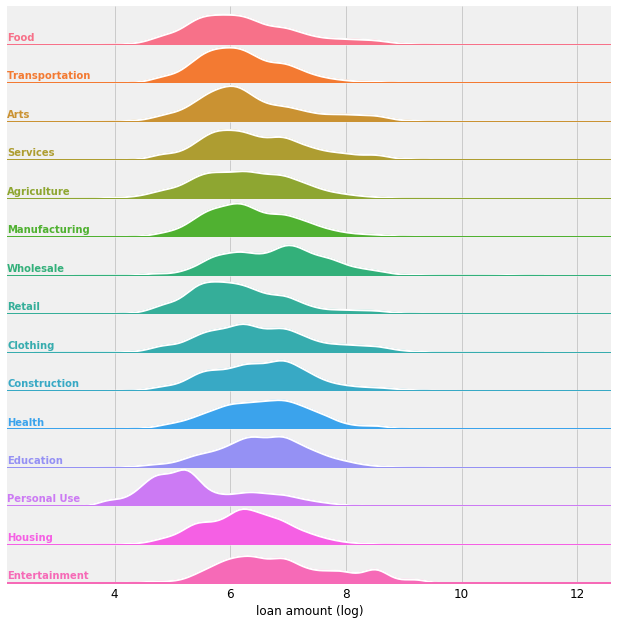

In [23]:
# Joy plot 
tmp = loan[['loan_amount','sector']]
tmp['loan_amount'] = np.log(tmp['loan_amount'])
g = sns.FacetGrid(tmp,row='sector',hue='sector',aspect=15, size=0.6)

# Draw the densities in a few steps
g.map(sns.kdeplot, "loan_amount", clip_on=False, shade=True, alpha=1, lw=1.5, bw=.2)
g.map(sns.kdeplot, "loan_amount", clip_on=False, color="w", lw=2, bw=.2)
g.map(plt.axhline, y=0, lw=2, clip_on=False)

# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color, 
            ha="left", va="center", transform=ax.transAxes)

g.map(label, "loan_amount")

# Set the subplots to overlap
g.fig.subplots_adjust(hspace=0)

# Remove axes details that don't play will with overlap
g.set_titles("")
g.set(yticks=[])
g.set(xlabel = 'loan amount (log)')
g.despine(bottom=True, left=True)
g.savefig('joy.png')

>The loan given for agriculture sector is top followed by food sector. When we look at the average loan for agriculture which much lesser than Entertainment sector. The entertainment sector account for 830 loan application where as agriculture 180302 but still average loan amount for entertainment  sector is top in the list. 

>The joy plot of loan amount is draw in second row, where loan amount is transformed to $log10$ and ordered by average loan amount

In [24]:
# Number of loan in different sector by country
sc = pd.crosstab(loan['country'],loan['sector'])
sc.style.background_gradient(cmap='YlGn')

sector,Agriculture,Arts,Clothing,Construction,Education,Entertainment,Food,Health,Housing,Manufacturing,Personal Use,Retail,Services,Transportation,Wholesale
country,,,,,,,,,,,,,,,
Afghanistan,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0
Albania,719,5,87,30,93,5,79,271,378,21,89,40,70,40,7
Armenia,4630,49,263,144,1293,13,361,748,45,75,162,260,389,184,15
Azerbaijan,1148,4,35,47,37,0,229,73,44,19,14,78,110,105,2
Belize,125,0,0,0,0,0,0,0,0,0,0,0,0,0,0
Benin,2,1,12,0,0,0,215,0,0,3,0,236,28,0,0
Bhutan,0,2,0,0,0,0,0,0,0,0,0,0,0,0,0
Bolivia,1257,402,718,186,440,20,2385,267,429,195,83,1087,1021,313,3
Brazil,2,22,61,6,0,0,47,2,0,1,0,70,70,1,2


### Distribution of Activity
what are the activity caried out by use loan amount?

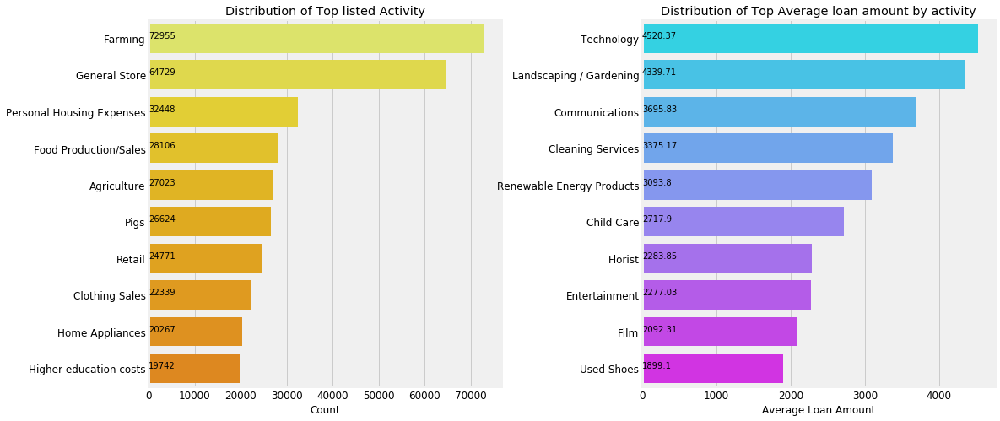

In [25]:
f,ax = plt.subplots(1,2,figsize=(16,8))
poo = loan['activity'].value_counts()[:10]
sns.barplot(poo.values,poo.index, palette='Wistia',ax= ax[0])
ax[0].set_title('Distribution of Top listed Activity')
ax[0].set_xlabel('Count')
for i, v in enumerate(poo.values): 
            ax[0].text(.6,i, round(v,2),fontsize=10,color='k')

poo = loan.groupby('activity').mean()['loan_amount'].sort_values(ascending=False)[:10]
sns.barplot(poo.values, poo.index, palette='cool', ax=ax[1])
ax[1].set_title('Distribution of Top Average loan amount by activity')
ax[1].set_ylabel('')
ax[1].set_xlabel('Average Loan Amount')
for i, v in enumerate(poo.values): 
            ax[1].text(1,i, round(v,2),fontsize=10,color='k')
plt.subplots_adjust(wspace=0.4)

>As we seen agriculture is sector accounts for top loan applied, so in the agriculture sector Farming, Pigs, Agriculture activity are top caried out. The people spending more on education as higher education cost increase by year. The loa taken for General store, Personal Housing Expenses is top in the list. As we all these activity are in rural area. 

>The average loan amount for technology accounts for highest in the list. There different techonlogy such as Communication, renewable energy are also having more average loan amounts spend. The used shoes activity 



### Distribution of repayment interval
Let's look at the polular repayment interval

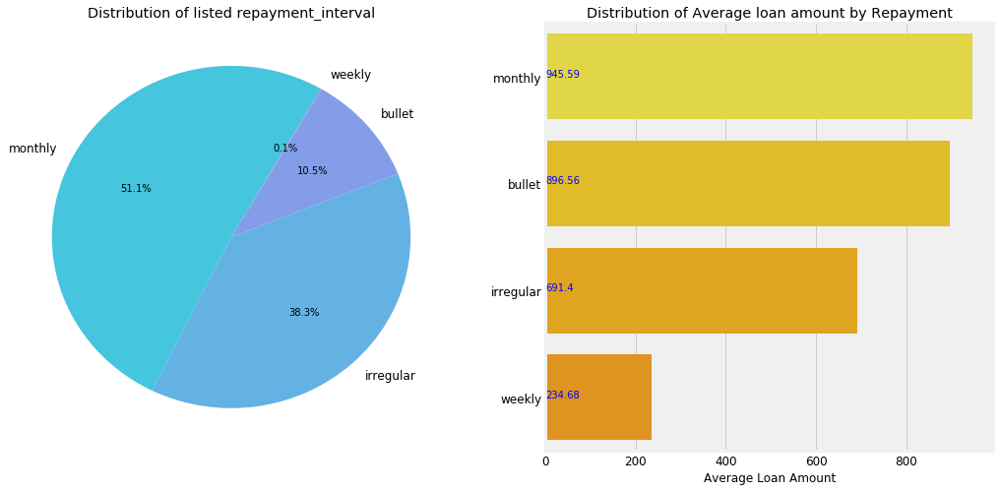

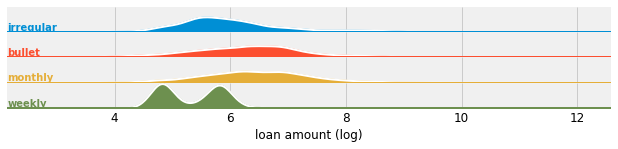

In [26]:
plt.figure(figsize =(16,8))
gridspec.GridSpec(2,2)

plt.subplot2grid((1,2),(0,0))
poo = loan['repayment_interval'].value_counts()
plt.pie(poo.values,labels= poo.index,autopct='%1.1f%%',startangle=60,colors=sns.color_palette('cool',desat=.7))
plt.title('Distribution of listed repayment_interval')

plt.subplot2grid((1,2),(0,1))
poo = loan.groupby('repayment_interval').mean()['loan_amount'].sort_values(ascending=False)
sns.barplot(poo.values,poo.index, palette='Wistia')
plt.title('Distribution of Average loan amount by Repayment')
plt.xlabel('Average Loan Amount')
plt.ylabel('')
for i, v in enumerate(poo.values): 
            plt.text(1,i, round(v,2),fontsize=10,color='b')


# Joy plot 
tmp = loan[['loan_amount','repayment_interval']]
tmp['loan_amount'] = np.log(tmp['loan_amount'])
g = sns.FacetGrid(tmp,row='repayment_interval',hue='repayment_interval',aspect=15, size=0.6)

# Draw the densities in a few steps
g.map(sns.kdeplot, "loan_amount", clip_on=False, shade=True, alpha=1, lw=1.5, bw=.2)
g.map(sns.kdeplot, "loan_amount", clip_on=False, color="w", lw=2, bw=.2)
g.map(plt.axhline, y=0, lw=2, clip_on=False)

# Define and use a simple function to label the plot in axes coordinates
def label(x, color, label):
    ax = plt.gca()
    ax.text(0, .2, label, fontweight="bold", color=color, 
            ha="left", va="center", transform=ax.transAxes)

g.map(label, "loan_amount")

# Set the subplots to overlap
g.fig.subplots_adjust(hspace=0)

# Remove axes details that don't play will with overlap
g.set_titles("")
g.set(yticks=[])
g.set(xlabel = 'loan amount (log)')
g.despine(bottom=True, left=True)
        
plt.subplots_adjust(wspace=0.3);

>The more than 50% repayment made monthly where as 38% irregualr, 10% bullet. If we look at second plot the average loan amount 945$USD$ monthly follwed by 896$USD$ bullet. The bullet repayment when loan borrower count not repay with in loan term.

### Top Country by  Repayment Interval
Let's look at the countries popular repayment interval

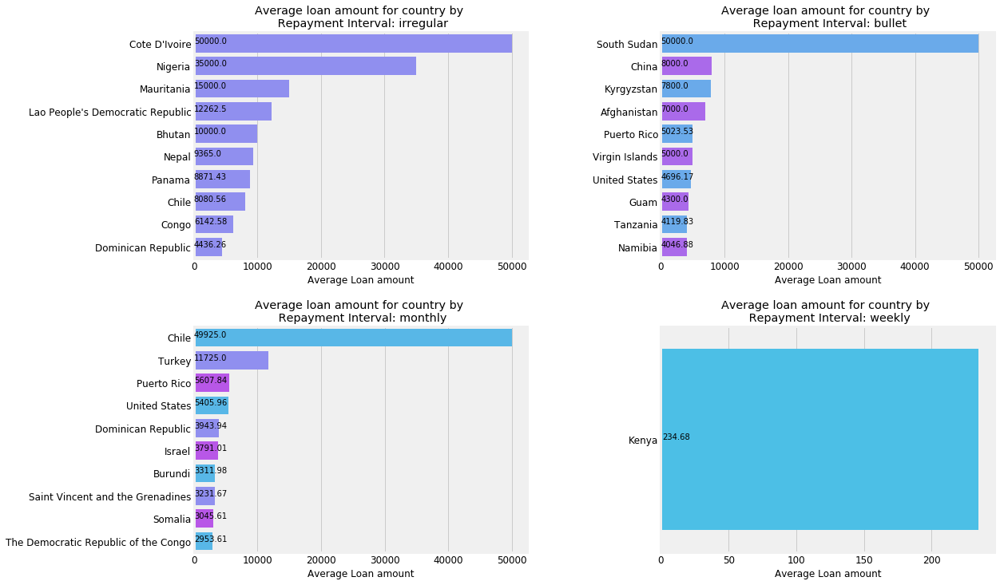

In [27]:
f,ax = plt.subplots(2,2,figsize=(16,12))
axs = ax.ravel()
for i,c in enumerate(loan['repayment_interval'].unique()):
    k = loan[loan['repayment_interval'] == c]
    agg = k.groupby(['country']).mean()['loan_amount'].sort_values(ascending=False).dropna()[:10]
    if i<4:
        sns.barplot(x = agg.values,y = agg.index, ax= axs[i],palette=sns.color_palette('cool',n_colors=i+1))
        axs[i].set_title('Average loan amount for country by \n Repayment Interval: {}'.format(c))
        axs[i].set_ylabel('')
        axs[i].set_xlabel('Average Loan amount')
        for j, v in enumerate(agg.values): 
            axs[i].text(1,j, round(v,2),fontsize=10,color='k')
plt.subplots_adjust(wspace=0.4,hspace=0.3)

* The average loan amount recoverd by type of repayment interval for differne country
* Kenya is only country which pay loan by weekly

### Distribution of terms in months
Let's look at term of loan in month

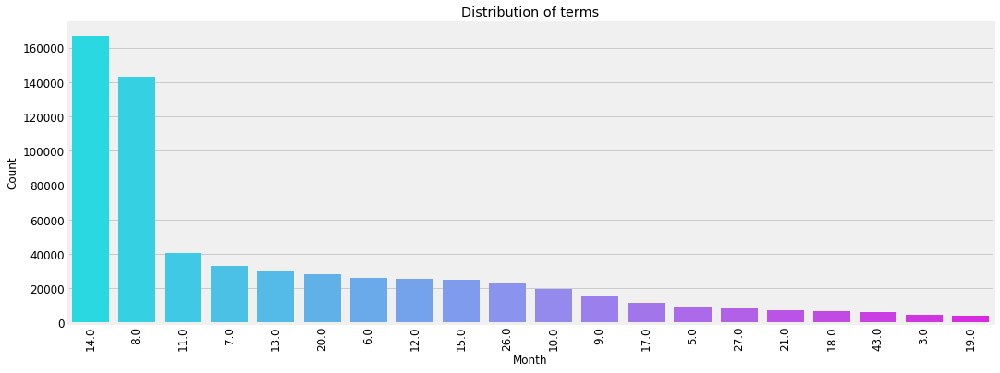

In [28]:
plt.figure(figsize=(16,6))
poo = loan['term_in_months'].value_counts().iloc[:20]
sns.barplot(y = poo.values, x = poo.index, palette= 'cool',order=poo.index)
plt.xticks(rotation=90)
plt.xlabel('Month')
plt.ylabel('Count')
plt.title('Distribution of terms');

* The 14 month of repayment interval is most popular choise followed by 8 month

### Distribution of Lender count
Let's look at the lender count

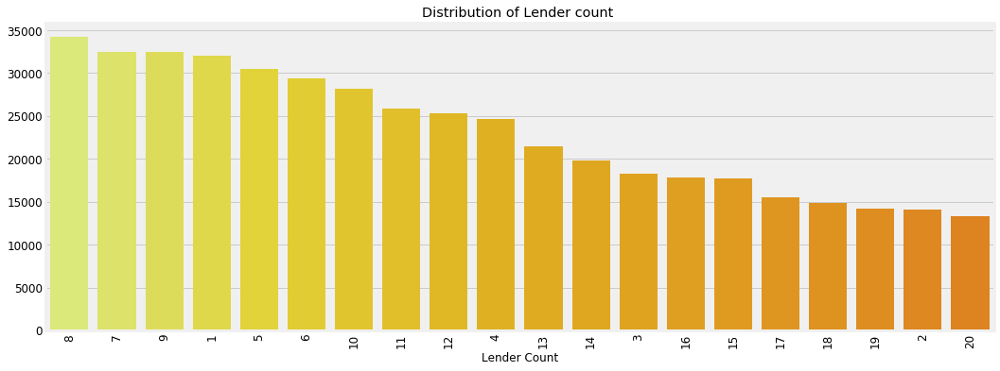

In [29]:
plt.figure(figsize=(16,6))
poo = loan['lender_count'].value_counts().iloc[:20]
sns.barplot(y = poo.values, x = poo.index, palette= 'Wistia',order=poo.index)
plt.xticks(rotation=90)
plt.xlabel('Lender Count')
plt.title('Distribution of Lender count ');

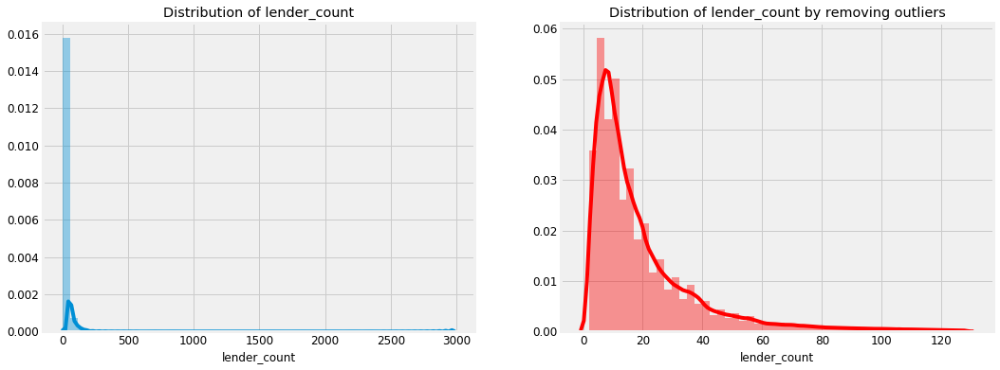

In [30]:
f,ax = plt.subplots(1,2,figsize=(16,6))
sns.distplot(loan['lender_count'],ax=ax[0])
ax[0].set_title('Distribution of lender_count')

ulimit = np.percentile(loan['lender_count'],99)
llimit= np.percentile(loan['lender_count'],1)
value = loan[(llimit<loan['lender_count'])&(loan['lender_count']<ulimit)]['lender_count']
sns.distplot(value,color='r',ax=ax[1])
ax[1].set_title('Distribution of lender_count by removing outliers');


* The 8,7,9,1 are polular lender count

### Loan amount usage
Let's use wordcloud to top amount usage

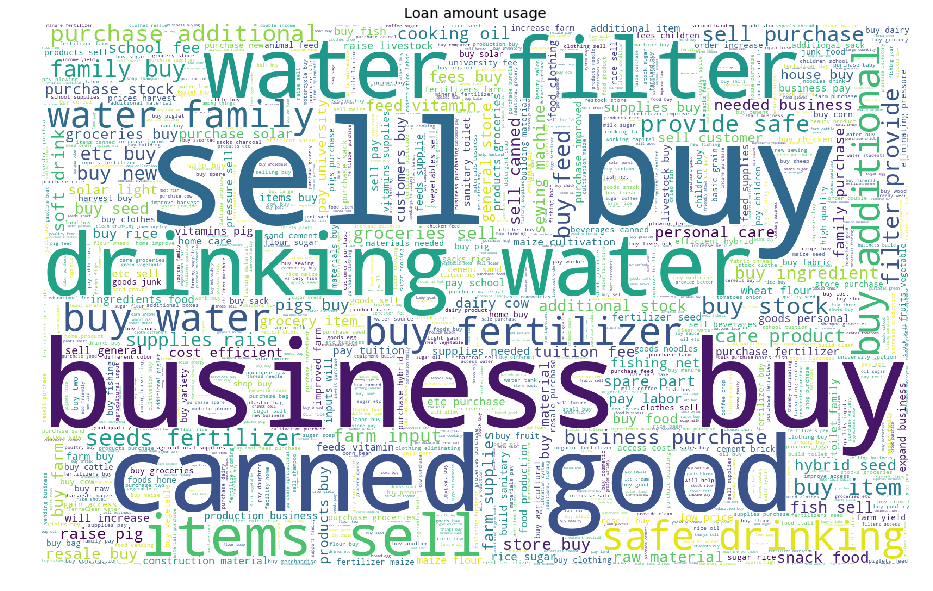

In [31]:
#use
wc = (WordCloud(height= 1000,width=1600, stopwords=STOPWORDS,max_words=1000,background_color='white')
      .generate(" ".join(loan['use'].astype(str))) )
plt.figure(figsize=(16,10))
plt.imshow(wc)
plt.axis('off')
#plt.savefig('cloud.png')
plt.title('Loan amount usage');

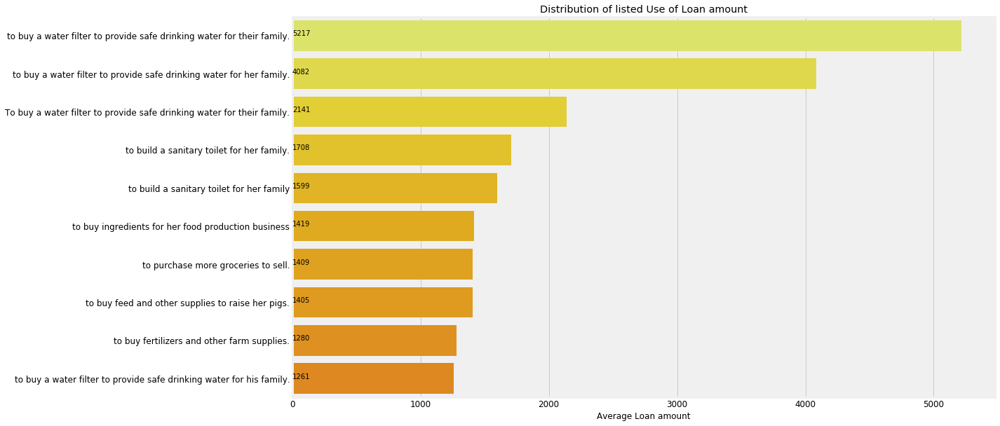

In [32]:
plt.figure(figsize=(16,10))
poo = loan['use'].value_counts()[:10]
sns.barplot(poo.values,poo.index, palette='Wistia')
plt.title('Distribution of listed Use of Loan amount')
plt.xlabel('Average Loan amount')
for i, v in enumerate(poo.values): 
        plt.text(.6,i, round(v,2),fontsize=10,color='k')
        plt.rc('ytick', labelsize=20);
plt.rc('ytick', labelsize=10);

>It is intresting that loan amount used to buy drinking water, water filter,to build toilet. It is government resposiblity to provide clean water, and toilet. If we look at the usage discription they mentioned **her family, their family**. It may be for marraige gift.

### Tags

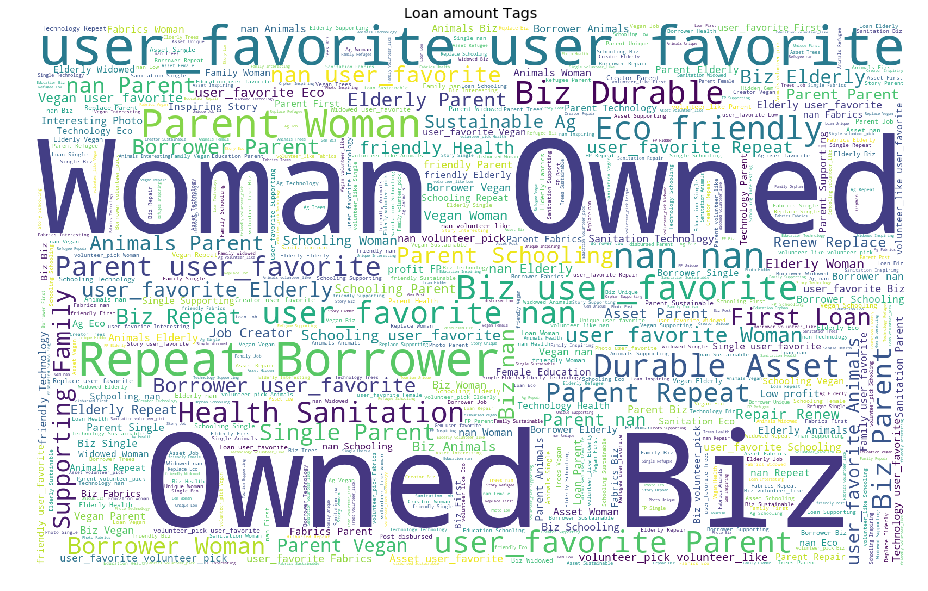

In [33]:
#tags
wc = (WordCloud(height= 1000,width=1600, stopwords=STOPWORDS,max_words=1000,background_color='white')
      .generate(" ".join(loan['tags'].astype(str))) )
plt.figure(figsize=(16,10))
plt.imshow(wc)
plt.axis('off')
plt.title('Loan amount Tags');

Women owned, Owned Biz are most popular tags

### Distribution of Gender

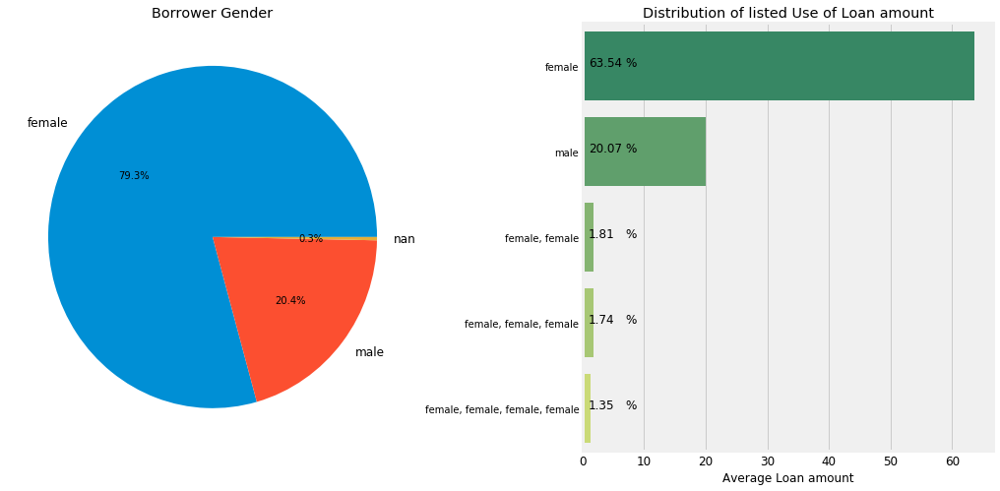

In [34]:
gender = ",".join(loan['borrower_genders'].astype(str).str.replace(' ',''))

cnt = pd.DataFrame(gender.strip().split(','),columns=['Gender'])
cnt = cnt['Gender'].value_counts()

f,ax = plt.subplots(1,2,figsize=(16,8))
ax[0].pie(cnt.values,labels=cnt.index,autopct='%0.1f%%')
ax[0].set_title('Borrower Gender')

poo = loan['borrower_genders'].value_counts()[:5]*100/loan.shape[0]
#ax[1].pie(poo.values,labels=poo.index,autopct='%0.1f%%')
sns.barplot(poo.values,poo.index, palette='summer')
ax[1].set_title('Distribution of listed Use of Loan amount')
ax[1].set_xlabel('Average Loan amount')
for i,v in enumerate(poo.values):
    ax[1].text(1,i,round(v,2),fontsize=12)
    ax[1].text(7,i,'%',fontsize=12)
plt.subplots_adjust(wspace=0.4)

> The 80% of loan borrower are female, 0.3% Nan value present in data set for gender. If we look at the second plot more than 60% individual female loan borrowers, where as 20% are male individual borrower

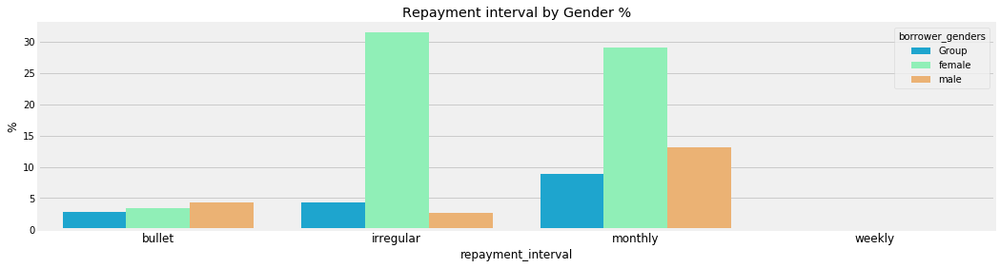

In [35]:
poo = (loan
       .groupby(['borrower_genders','repayment_interval'])
       .agg(['count'])['id'].reset_index())
poo.loc[:,'borrower_genders'][~((poo['borrower_genders'] == 'female') |(poo['borrower_genders'] == 'male'))] = 'Group'


plt.figure(figsize=(16,4))
cnt = poo.groupby(['borrower_genders','repayment_interval'])['count'].sum().reset_index()
cnt['count'] = cnt['count']*100/cnt['count'].sum()
sns.barplot(y= cnt['count'],x = cnt['repayment_interval'],hue=cnt['borrower_genders'],palette='rainbow')
plt.title('Repayment interval by Gender %')
plt.ylabel('%');

> More than 30% female individual repay loan in irregular interval where as 28 % monthly. The male prefer monthly repayment interval. About 14% male individual repay monthly and 3% by irregular. 
The bullet repayment when loan borrower count not repay with in loan term.

### Date time feature

In [36]:
loan['date'] = pd.to_datetime(loan['date'])
loan['disbursed_time'] = pd.to_datetime(loan['disbursed_time'])
loan['funded_time'] = pd.to_datetime(loan['funded_time'])
loan['posted_time'] = pd.to_datetime(loan['posted_time'])
loan_ts = loan.set_index('date')

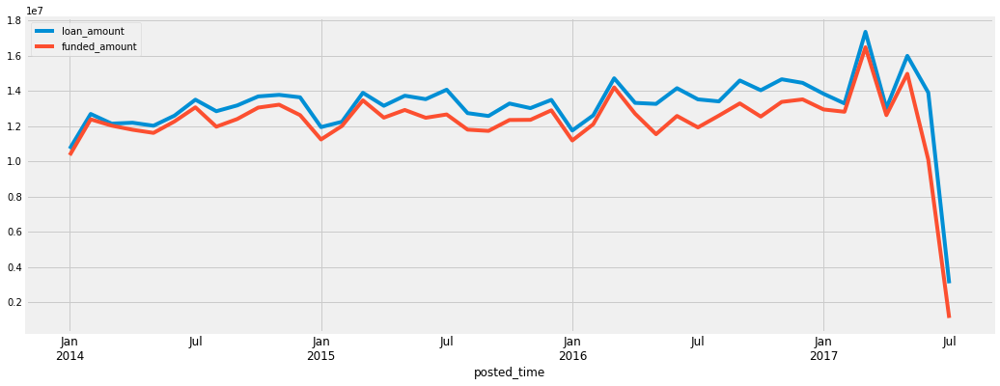

In [37]:
plt.figure(figsize=(16,6))
date_feature = ['posted_time','funded_time']
loan.set_index('posted_time')['loan_amount'].resample('M').sum().plot()
loan.set_index('posted_time')['funded_amount'].resample('M').sum().plot()
plt.legend()


### Relation between Sector and activity
Let's look into few activity in different sectors 

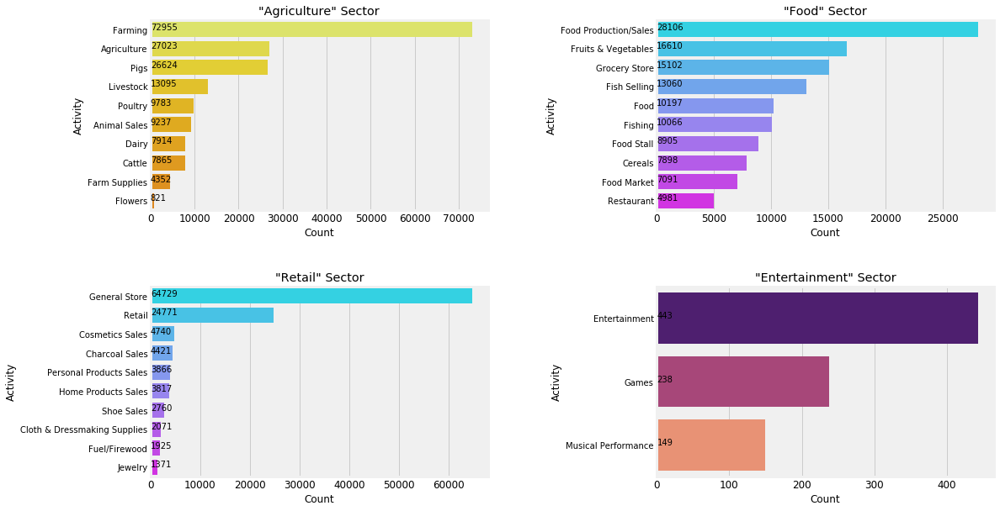

In [38]:
plt.figure(figsize=(16,10))
gridspec.GridSpec(2,2)
# Agriclure 
plt.subplot2grid((2,2),(0,0))
poo = loan[loan['sector'] =='Agriculture']['activity'].value_counts()[:10]
sns.barplot(poo.values,poo.index,palette='Wistia')
plt.ylabel('Activity')
plt.xlabel('Count')
plt.title('"Agriculture" Sector')
for i, v in enumerate(poo.values): 
        plt.text(.6,i, round(v,2),fontsize=10,color='k')

plt.subplot2grid((2,2),(0,1))
poo = loan[loan['sector'] =='Food']['activity'].value_counts()[:10]
sns.barplot(poo.values,poo.index,palette='cool')
plt.ylabel('Activity')
plt.xlabel('Count')
plt.title('"Food" Sector')
for i, v in enumerate(poo.values): 
        plt.text(.6,i, round(v,2),fontsize=10,color='k')

plt.subplot2grid((2,2),(1,0))
poo = loan[loan['sector'] =='Retail']['activity'].value_counts()[:10]
sns.barplot(poo.values,poo.index,palette='cool')
plt.ylabel('Activity')
plt.xlabel('Count')
plt.title('"Retail" Sector')
for i, v in enumerate(poo.values): 
        plt.text(.6,i, round(v,2),fontsize=10,color='k')

plt.subplot2grid((2,2),(1,1))
poo = loan[loan['sector'] =='Entertainment']['activity'].value_counts()[:10]
sns.barplot(poo.values,poo.index,palette='magma')
plt.ylabel('Activity')
plt.xlabel('Count')
plt.title('"Entertainment" Sector')
for i, v in enumerate(poo.values): 
        plt.text(.6,i, round(v,2),fontsize=10,color='k')

plt.subplots_adjust(hspace=0.4,wspace=0.5);

>In the agriculture sector there are farming, agriculture,pigs, poultry,dairy activities. There broadly there are three types of activities such as Farming or growning crops, Animal husbanry, Trading of related products. 

>The farming involves cultivation,protection, processing of crops. The agriculture involves more family labore.
Livestock are domesticated animals raised in an agricultural setting to produce labor and commodities such as meat, eggs, milk, fur, leather, jewellery and wool.

## MPI (Multidimensional Poverty Index)
MPI (*Multidimensional Poverty Index*) is measure of poverty of people living in diffirent parts of country.

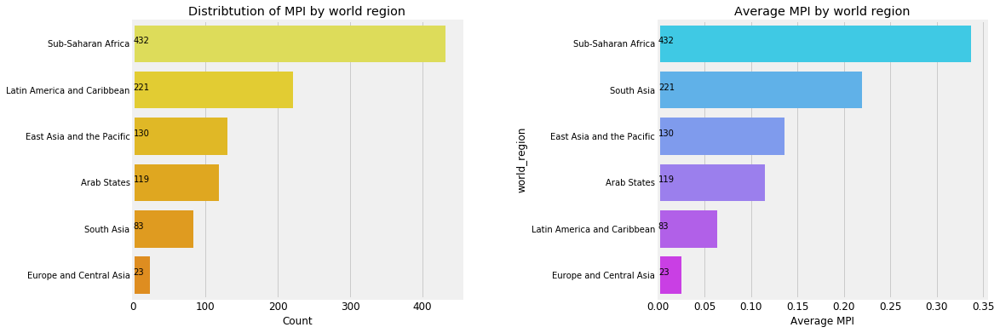

In [39]:
f,ax = plt.subplots(1,2,figsize=(16,6))
poo = mpi['world_region'].value_counts()
sns.barplot(poo.values, poo.index,palette=sns.color_palette('Wistia'),ax=ax[0])
ax[0].set_title('Distribtution of MPI by world region')
ax[0].set_xlabel('Count')
for i, v in enumerate(poo.values):
    ax[0].text(.6,i, round(v,2),fontsize=10,color='k')
agg = mpi.groupby(['world_region']).mean()['MPI'].sort_values().dropna().sort_values( ascending=False)
sns.barplot(agg.values, agg.index,palette=sns.color_palette('cool'),ax=ax[1])
ax[1].set_xlabel('Average MPI')
ax[1].set_title('Average MPI by world region')
for i, v in enumerate(poo.values):
    ax[1].text(0,i, round(v,2),fontsize=10,color='k')
plt.subplots_adjust(wspace=0.6);

###  Average MPI by region

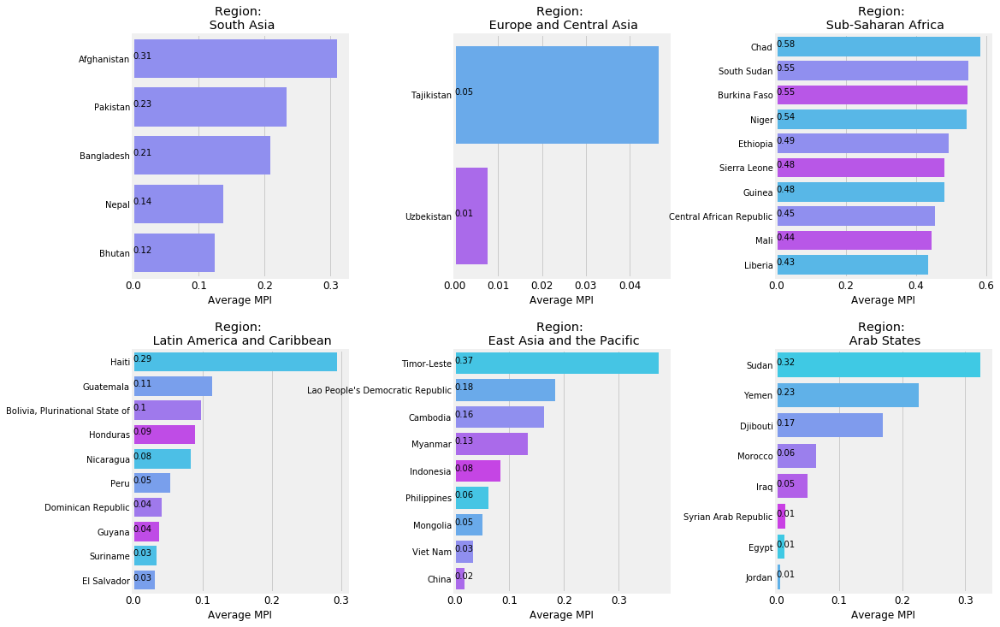

In [40]:

f,ax = plt.subplots(2,3,figsize=(16,12))
axs = ax.ravel()
for i,c in enumerate(mpi['world_region'].unique()):
    k = mpi[mpi['world_region'] == c]
    agg = k.groupby(['country']).mean()['MPI'].sort_values(ascending=False).dropna()[:10]
    if i<6:
        sns.barplot(x = agg.values,y = agg.index, ax= axs[i],palette=sns.color_palette('cool',n_colors=i+1))
        axs[i].set_title('Region: \n {}'.format(c))
        axs[i].set_xlabel('Average MPI')
        axs[i].set_ylabel('')
        for j, v in enumerate(agg.values):
            axs[i].text(0,j,round(v,2),fontsize=10,color='k')

plt.subplots_adjust(wspace=0.5,hspace=0.3);

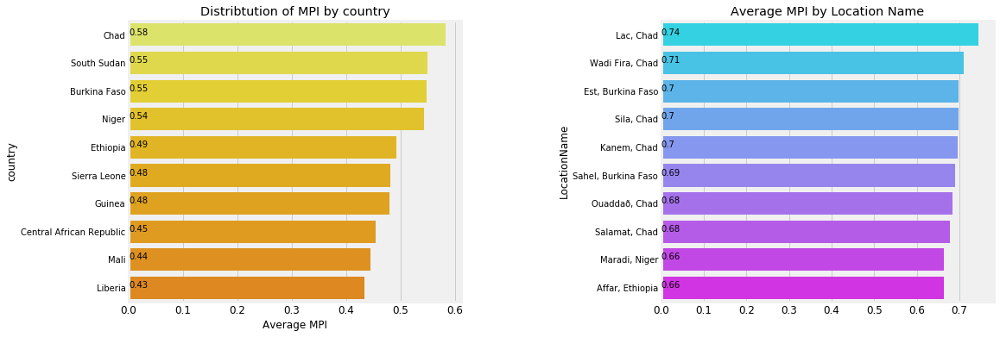

In [41]:
f,ax = plt.subplots(1,2,figsize=(16,6))
agg = mpi.groupby(['country']).mean()['MPI'].sort_values().dropna().sort_values( ascending=False)[:10]
sns.barplot(agg.values, agg.index,palette='Wistia',ax=ax[0])
ax[0].set_title('Distribtution of MPI by country')
ax[0].set_xlabel('Average MPI')
for i, v in enumerate(agg.values):
    ax[0].text(0,i, round(v,2),fontsize=10,color='k')

agg = mpi.groupby(['LocationName']).mean()['MPI'].sort_values().dropna().sort_values( ascending=False)[:10]
sns.barplot(agg.values, agg.index,palette='cool',ax=ax[1])
for i, v in enumerate(agg.values):
    ax[1].text(0,i, round(v,2),fontsize=10,color='k')

ax[1].set_title('Average MPI by Location Name')
ax[0].set_xlabel('Average MPI')
plt.subplots_adjust(wspace=0.6);

### MPI map veiw

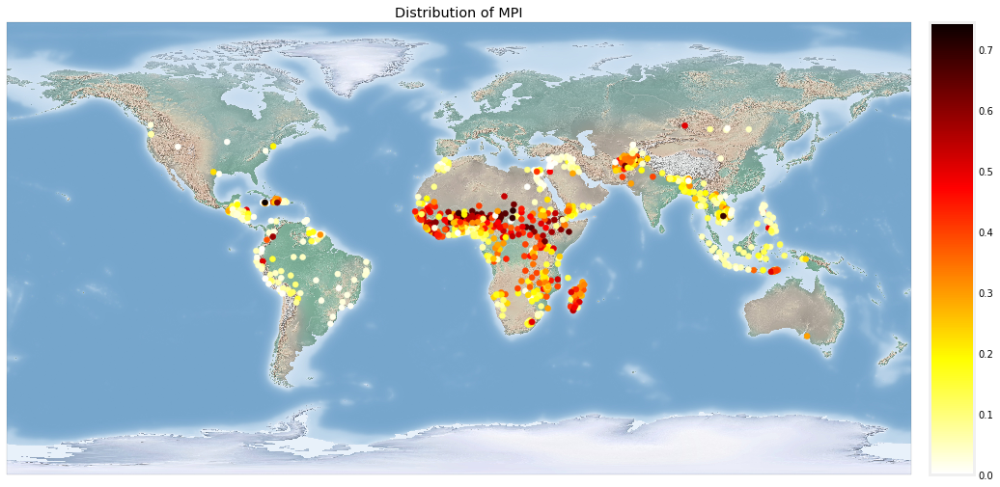

In [43]:
# MPI
plt.figure(figsize=(16,10))
m = Basemap(projection='cyl',resolution='c',)
m.drawcoastlines(linewidth=0.1, color="white")
#m.fillcontinents(color='#f2f2f2',lake_color='#46bcec')
m.drawmapboundary(fill_color='#A6CAE0', linewidth=0.1)
#m.bluemarble(alpha=0.4)
m.shadedrelief()

values = mpi['MPI']
mloc = m(mpi['lon'],mpi['lat'])
m.scatter(mloc[0],mloc[1],c = values,zorder=20,cmap='hot_r')
m.colorbar()
plt.title('Distribution of MPI')
plt.show()
m
gc.collect();

In [44]:
# http://nbviewer.jupyter.org/github/python-visualization/folium/blob/master/examples/MarkerCluster.ipynb
loc = mpi[['lon','lat','region','MPI']].dropna()
m = folium.Map(location=[0,0],zoom_start=2)

#c = folium.StepColormap(colors=sns.color_palette('magma')) # color4
c = ['#2288ff','#3322ff','#1144ff']
l = [0.3,0.5,0.7]
for i,j,k in zip(loc['lat'],loc['lon'],loc['MPI']):
    
    # color scale
    for r in range(2):
        if k>=l[r]:
            color = c[r]
    # Marker
    marker = folium.Circle(location=[i,j],popup=str(k),radius=k*100,
                                 color=color,fill=True,fill_color=color)
    #folium.LatLngPopup().add_child(marker)
    marker.add_to(m)
m

## HDI 
Human development report of year 2015

In [45]:
gc.collect()
hdi.head()

,Unnamed: 0,Id,Country,HDI Rank,HDI,Life expectancy,Mean years of schooling,Gross national income (GNI) per capita,GNI per capita rank minus HDI rank,Change in HDI rank 2010-2015,...,Coefficient of human inequality,Inequality in life expectancy (%) 2010-2015,Inequality-adjusted life expectancy index,Inequality in education(%),Inequality-adjusted education index,Inequality in income (%),Inequality-adjusted income index,Income inequality (Quintile ratio) 2010-2015,Income inequality (Palma ratio) 2010-2015,Income inequality (Gini coefficient) 2010-2015
0,0,1,Norway,1.0,0.949,81.7,12.7,67614.0,5.0,0.0,...,5.4,3.3,0.918,2.4,0.894,10.4,0.882,3.8,0.9,25.9
1,1,2,Australia,2.0,0.939,82.5,13.2,42822.0,19.0,1.0,...,8.0,4.3,0.921,1.9,0.921,17.7,0.753,6.0,1.4,34.9
2,2,3,Switzerland,2.0,0.939,83.1,13.4,56364.0,7.0,0.0,...,8.4,3.8,0.934,5.7,0.840,15.7,0.806,4.9,1.2,31.6
3,3,4,Germany,4.0,0.926,81.1,13.2,45000.0,13.0,0.0,...,7.0,3.7,0.905,2.6,0.891,14.8,0.787,4.6,1.1,30.1
4,4,5,Denmark,5.0,0.925,80.4,12.7,44519.0,13.0,2.0,...,7.0,3.8,0.894,3.0,0.896,14.3,0.789,4.5,1.0,29.1


In [46]:
continent_hdi.head()

,Unnamed: 0,Id,Human development groups,HDI,Life_ expectancy,Mean years of schooling,Gross national income (GNI) per capita,Average annual HDI growth 1990-2000,Average annual HDI growth 2000-2010,Average annual HDI growth 2010-2015,...,Internet users (% 2010 -2015),Inequality-adjusted HDI (IHDI),Inequality-adjusted HDI (IHDI) Over loss(%),Coefficient of human inequality,Inequality in life expectancy (%) 2010-2015,Inequality-adjusted life expectancy index,Inequality in education(%),Inequality-adjusted education index,Inequality in income (%),Inequality-adjusted income index
0,0,1,Very high human development,0.892,79.4,12.2,39605,0.55,0.48,0.35,...,11.3,0.793,11.1,10.9,5.4,0.865,7.2,0.797,19.9,0.723
1,1,2,High human development,0.746,75.5,8.1,13844,1.04,1.19,0.83,...,19.4,0.597,20.0,19.6,10.5,0.764,18.3,0.535,30.0,0.521
2,2,3,Medium human development,0.631,68.6,6.6,6281,1.23,1.31,1.09,...,170.7,0.469,25.7,25.5,22.6,0.578,33.7,0.357,20.1,0.500
3,3,4,Low human development,0.497,59.3,4.6,2649,0.89,2.02,0.92,...,87.8,0.337,32.3,32.0,35.1,0.392,37.1,0.258,23.9,0.377
4,4,5,Developing countries,0.668,70.0,7.2,9257,1.02,1.18,0.85,...,78.5,0.499,25.2,25.1,19.6,0.619,31.0,0.391,24.7,0.515


In [47]:
basic_details(hdi).T

Number of rows 195 and columns 82


,Unnamed: 0,Id,Country,HDI Rank,HDI,Life expectancy,Mean years of schooling,Gross national income (GNI) per capita,GNI per capita rank minus HDI rank,Change in HDI rank 2010-2015,...,Coefficient of human inequality,Inequality in life expectancy (%) 2010-2015,Inequality-adjusted life expectancy index,Inequality in education(%),Inequality-adjusted education index,Inequality in income (%),Inequality-adjusted income index,Income inequality (Quintile ratio) 2010-2015,Income inequality (Palma ratio) 2010-2015,Income inequality (Gini coefficient) 2010-2015
dtype,int64,int64,object,float64,float64,float64,float64,float64,float64,float64,...,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
Number of unique value,195,195,195,156,156,147,86,193,64,25,...,122,138,169,134,141,119,132,81,33,108
Missing value,0,0,0,7,7,5,7,2,7,7,...,44,10,10,35,37,41,41,51,51,51
% missing value,0,0,0,0.0358974,0.0358974,0.025641,0.0358974,0.0102564,0.0358974,0.0358974,...,0.225641,0.0512821,0.0512821,0.179487,0.189744,0.210256,0.210256,0.261538,0.261538,0.261538


In [48]:
kiva_country = loan['country'].unique()
len(kiva_country)
kiva_hdi = hdi[hdi['Country'].apply(lambda c: c in kiva_country)]
kiva_hdi['Country'] = kiva_hdi['Country'].apply(lambda c: c in kiva_country)

### HDI:

In [49]:
m = folium.Map(location=[0,0],zoom_start=2)

m.choropleth(geo_data= geo_world_data,
             data = hdi, columns=['Country','HDI'],key_on='feature.properties.name',name='HDI',
             fill_opacity=1,fill_color='GnBu',highlight=True, 
             #threshold_scale=[100,1000,2000,4000,6000,10000],
            legend_name='HDI')
folium.LayerControl().add_to(m)
m

Human Development Index (HDI): 
A composite index measuring average achievement in three basic dimensions of human development 
1. A long and healthy life: is assessed by life expectancy at birth
2. Knowledge or Education: is mean year of schooling for adults  
3. A decent standard of living: is Gross National Income per capita

It does not reflect on inequalities, poverty, human security, empowerment, etc.

We find:
> The HDI in african countries is 0.4 to 0.7. The European, American countries are having very Hdi, Asian continent moderater hdi.

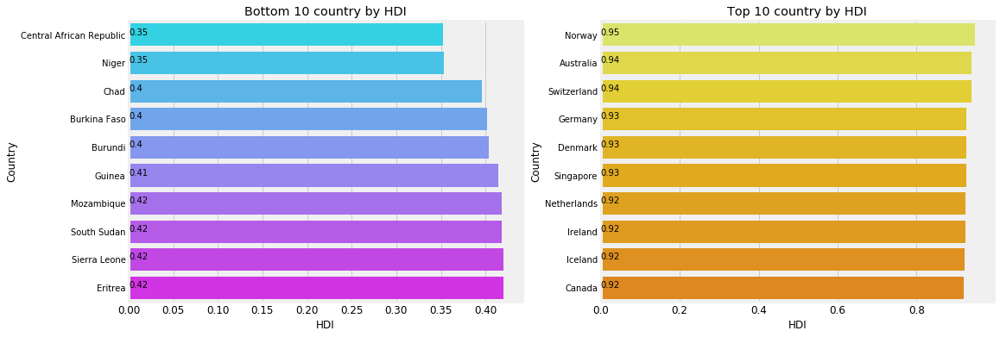

In [50]:
f,ax = plt.subplots(1,2,figsize=(16,6))
value = (hdi[['HDI','Country']]
         .sort_values(by='HDI')[:10])
sns.barplot(value['HDI'],value['Country'],palette='cool',ax=ax[0])
ax[0].set_title('Bottom 10 country by HDI')
for i, v in enumerate(value['HDI']):
    ax[0].text(0,i, round(v,2),fontsize=10,color='k')

value = (hdi[['HDI','Country']]
         .sort_values(by='HDI',ascending=False)[:10])
sns.barplot(value['HDI'],value['Country'],palette='Wistia',ax=ax[1])
ax[1].set_title('Top 10 country by HDI');
for i, v in enumerate(value['HDI']):
    ax[1].text(0,i, round(v,2),fontsize=10,color='k')


>The No.1 Hdi is Norway followed Australia,Switzerland. The lowest hdi in Cetral African Republic,Niger,Chad, the basic health care, education, life expectancy in these countries are very low. 

HDI Male vs Female

Mean value of HDI: 0.6988351063829784
Mean value of Human Development Index (HDI) Female: 0.68324375
Mean value of Human Development Index (HDI) Male: 0.7242624999999998


Text(0.5,1,'Human Development Index (HDI)')

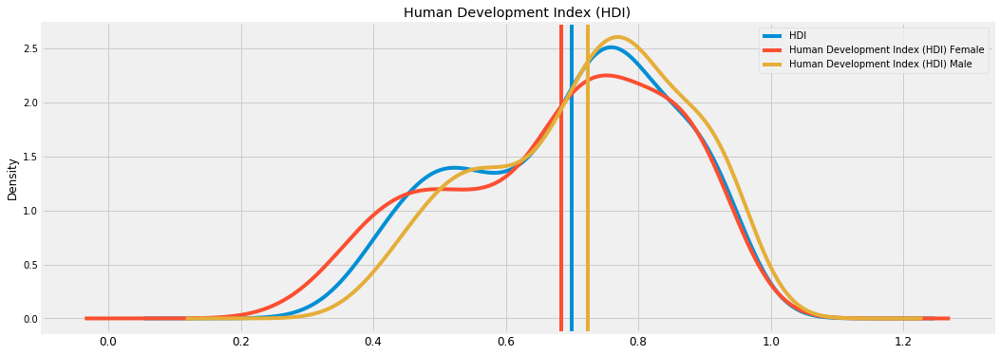

In [51]:
### col = hdi.columns[hdi.columns.str.contains('HDI')]
col = ['HDI','Human Development Index (HDI) Female','Human Development Index (HDI) Male']
f,ax = plt.subplots(figsize=(16,6))
for i,C in enumerate(col):
    hdi[C].plot(kind='kde',ax=ax,color='C{}'.format(i))
    mean = hdi[C].mean()
    ax.axvline(mean,c='C{}'.format(i))
    print('Mean value of {}: {}'.format(C,mean,))
    #ax.text(round(mean,0),0.1,round(mean,2))
    ax.legend()
plt.title('Human Development Index (HDI)')
#plt.savefig('hdi.png');

> This realy beatiful kde  plot, we can find HDI for female, male and average HDI varies at diferent level. The Mean HDI of Male > than Female for all country put together.
* Female > Average HDI > Male range 0.0 to 0.43,
* No proper inference range 0.43 to 0.62
* Female ~= Average HDI ~= Male range 0.62 to 0.69 
* Female < Average HDI < Male range 0.69 to 1.0 


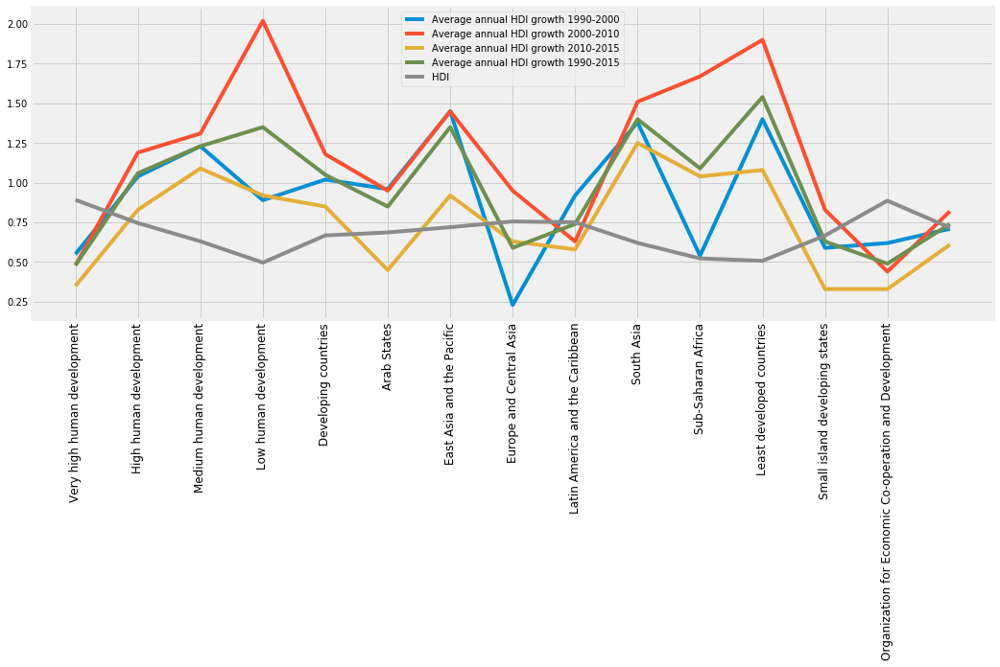

In [52]:
f,ax=plt.subplots(figsize=(16,6))
continent_hdi[['Human development groups','Average annual HDI growth 1990-2000','Average annual HDI growth 2000-2010',
       'Average annual HDI growth 2010-2015','Average annual HDI growth 1990-2015','HDI']].plot(ax=ax)
plt.xticks(np.arange(14),continent_hdi['Human development groups'],rotation=90);

### Life Expectancy

Mean value of Life expectancy: 71.26736842105268
Mean value of Life expectancy at birth Female: 73.49081081081077
Mean value of Life expectancy at birth Male: 68.74648648648653
Mean value of Life expectancy at age 59 (years) 2010/2015: 19.45513513513514


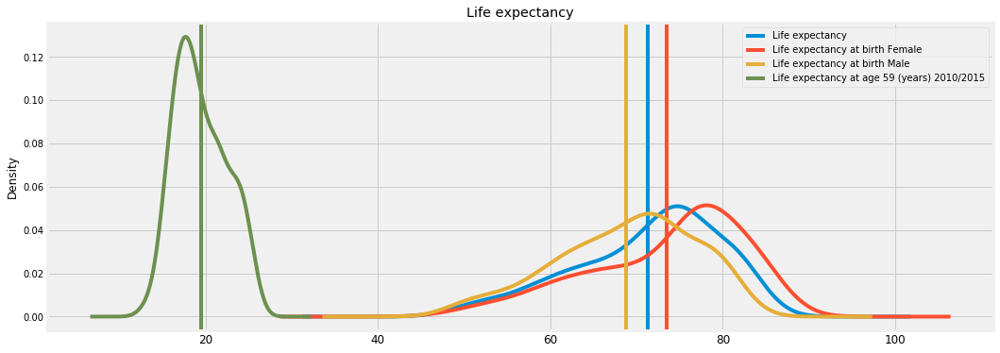

In [53]:
col = hdi.columns[hdi.columns.str.startswith('Life expectancy')]
f,ax = plt.subplots(figsize=(16,6))
for i,C in enumerate(col):
    hdi[C].plot(kind='kde',ax=ax,c='C{}'.format(i))
    mean = hdi[C].mean()
    ax.axvline(mean,c='C{}'.format(i))
    print('Mean value of {}: {}'.format(C,mean,))
    #ax.text(round(mean,0),0.1,round(mean,2))
    ax.legend()
plt.title('Life expectancy');

Life Expectacny Male < Mean < Female
> For life expectancy at 59 will add average 19 year, so life expecatancy will be 59+19= 78years. 



### Mean years of schooling

Mean value of Mean years of schooling: 8.371276595744675
Mean value of Mean years of schooling Female: 8.09585798816568
Mean value of Mean years of schooling Male: 8.836094674556213


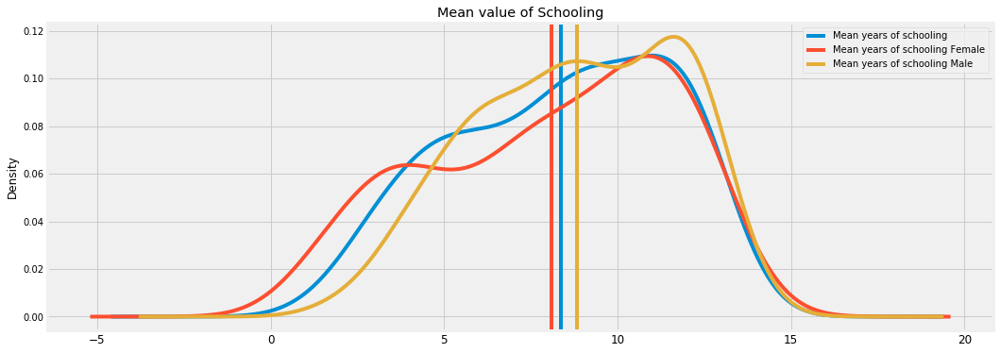

In [54]:
col = hdi.columns[hdi.columns.str.startswith('Mean years')]
f,ax = plt.subplots(figsize=(16,6))
for i,C in enumerate(col):
    hdi[C].plot(kind='kde',ax=ax,c='C{}'.format(i))
    mean = hdi[C].mean()
    ax.axvline(mean,c='C{}'.format(i))
    print('Mean value of {}: {}'.format(C,mean,))
    #ax.text(round(mean,0),0.1,round(mean,2))
    ax.legend()
plt.title('Mean value of Schooling');

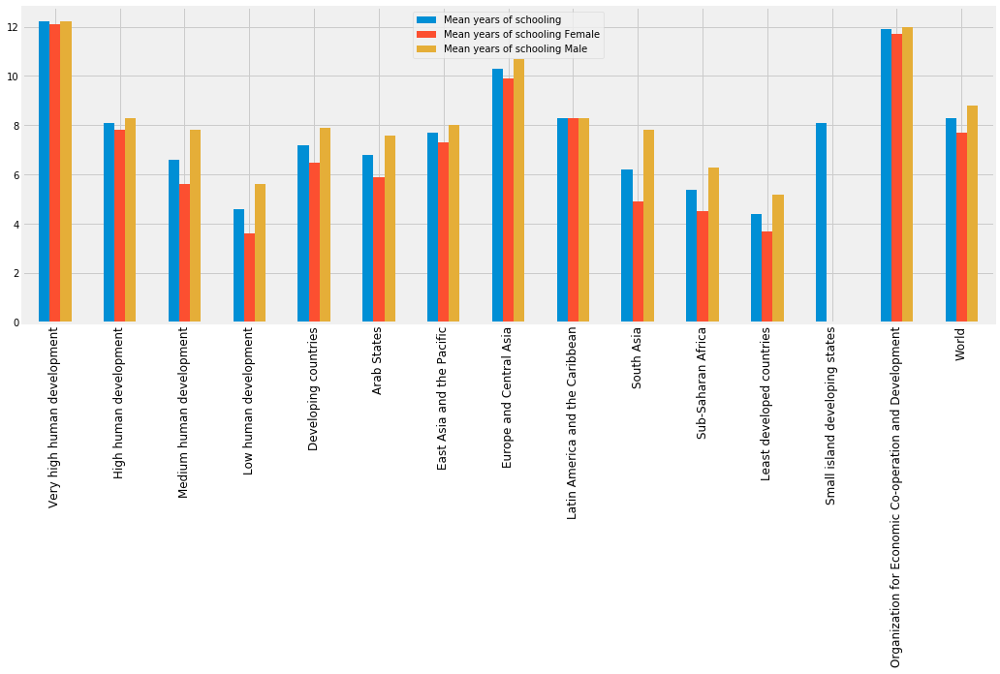

In [55]:
f,ax=plt.subplots(figsize=(16,6))
col = continent_hdi.columns[continent_hdi.columns.str.startswith('Mean years')]

continent_hdi[col].plot(ax=ax,kind='bar')
plt.xticks(np.arange(15),continent_hdi['Human development groups'],rotation=90);

### Share of seats in parliament (% held by women)

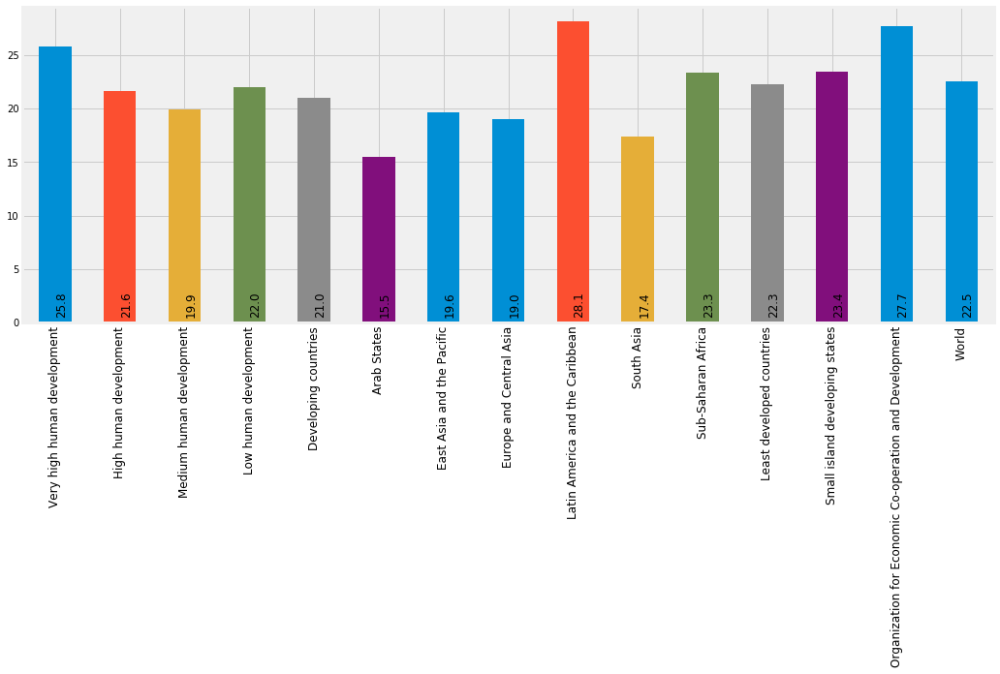

In [56]:
f,ax=plt.subplots(figsize=(16,6))

continent_hdi['Share of seats in parliament (% held by women)'].plot(kind='bar',ax=ax)
plt.xticks(np.arange(15),continent_hdi['Human development groups'],rotation=90)
for i,v in enumerate(continent_hdi['Share of seats in parliament (% held by women)']):
    plt.text(i,2,round(v,2),fontsize=12,rotation=90);

The latin America the Caribbean group of country having highest Women participation in parliament. The Arab States women participation in parliment is 15% which is less than  world average is 22%.

### Population

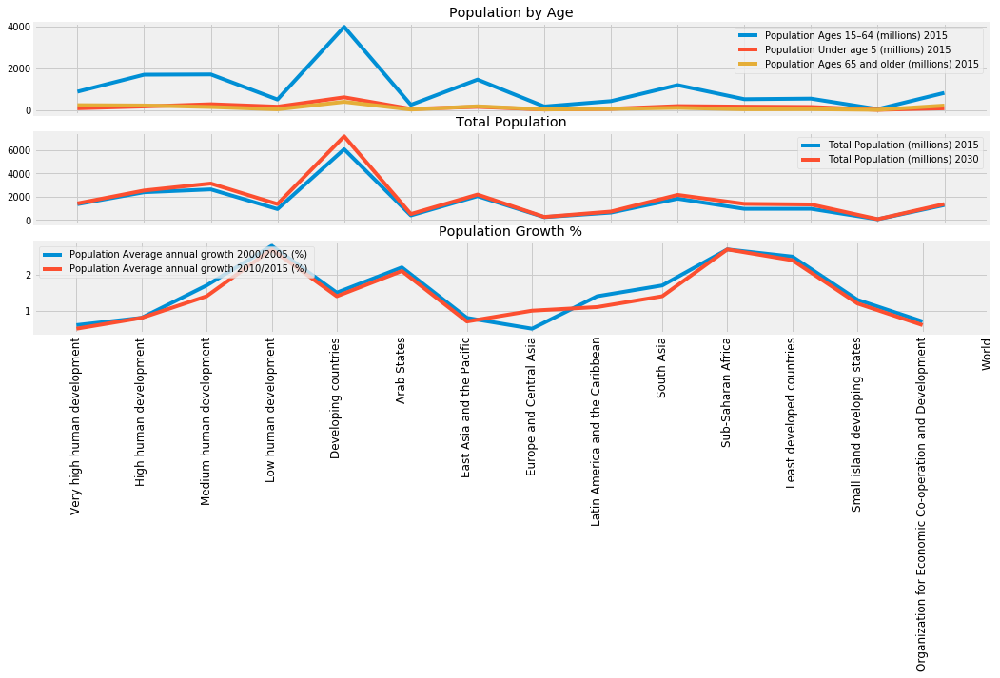

In [57]:
f,ax=plt.subplots(3,1,figsize=(16,6),sharex=True)
axs = ax.ravel()
col = ['Population Ages 15–64 (millions) 2015','Population Under age 5 (millions) 2015',
       'Population Ages 65 and older (millions) 2015','Human development groups']
continent_hdi[col].plot(ax=axs[0],kind='line')
axs[0].set_title('Population by Age')
col = ['Total Population (millions) 2015', 'Total Population (millions) 2030',]
continent_hdi[col].plot(ax=axs[1],kind='line')
axs[1].set_title('Total Population')

col = ['Population Average annual growth 2000/2005 (%) ','Population Average annual growth 2010/2015 (%) ']
continent_hdi[col].plot(ax=axs[2],kind='line')
axs[2].set_title('Population Growth %')
plt.xticks(np.arange(15),continent_hdi['Human development groups'],rotation=90);
#axs[2].set_xticklabels([x for x in continent_hdi['Human development groups']], rotation=90);


### Employment

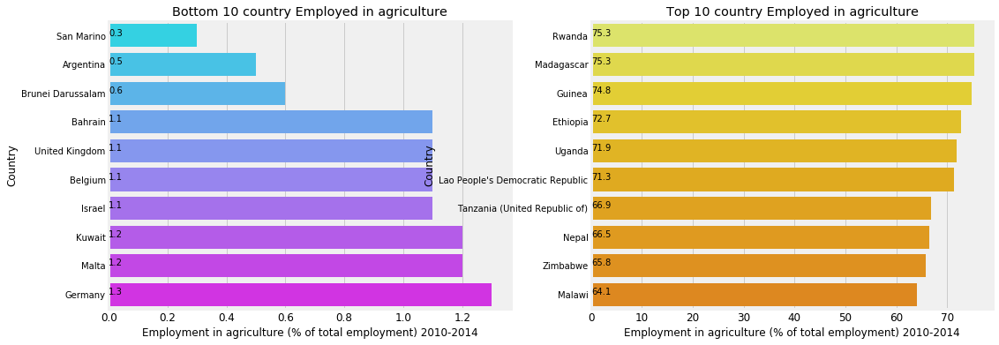

In [58]:
f,ax = plt.subplots(1,2,figsize=(16,6))
value = (hdi[['Employment in agriculture (% of total employment) 2010-2014','Country']]
         .sort_values(by='Employment in agriculture (% of total employment) 2010-2014')[:10])
sns.barplot(value['Employment in agriculture (% of total employment) 2010-2014'],value['Country'],palette='cool',ax=ax[0])
ax[0].set_title('Bottom 10 country Employed in agriculture')
for i, v in enumerate(value['Employment in agriculture (% of total employment) 2010-2014']):
    ax[0].text(0,i, round(v,2),fontsize=10,color='k')

value = (hdi[['Employment in agriculture (% of total employment) 2010-2014','Country']]
         .sort_values(by='Employment in agriculture (% of total employment) 2010-2014',ascending=False)[:10])
sns.barplot(value['Employment in agriculture (% of total employment) 2010-2014'],value['Country'],palette='Wistia',ax=ax[1])
ax[1].set_title('Top 10 country Employed in agriculture');
for i, v in enumerate(value['Employment in agriculture (% of total employment) 2010-2014']):
    ax[1].text(0,i, round(v,2),fontsize=10,color='k')


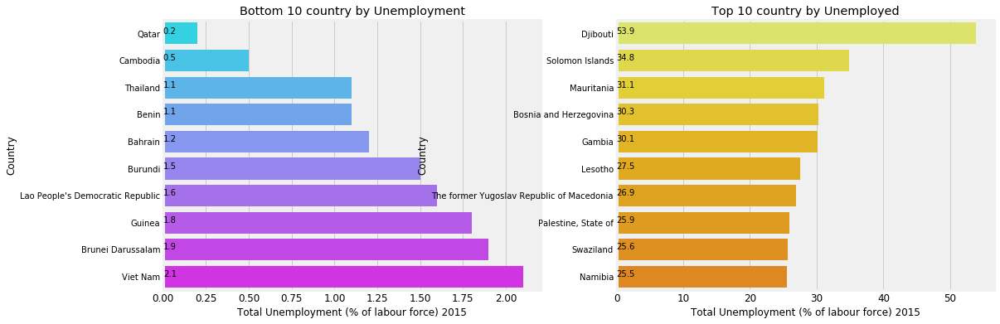

In [59]:
f,ax = plt.subplots(1,2,figsize=(16,6))
value = (hdi[['Total Unemployment (% of labour force) 2015','Country']]
         .sort_values(by='Total Unemployment (% of labour force) 2015')[:10])
sns.barplot(value['Total Unemployment (% of labour force) 2015'],value['Country'],palette='cool',ax=ax[0])
ax[0].set_title('Bottom 10 country by Unemployment')
for i, v in enumerate(value['Total Unemployment (% of labour force) 2015']):
    ax[0].text(0,i, round(v,2),fontsize=10,color='k')

value = (hdi[['Total Unemployment (% of labour force) 2015','Country']]
         .sort_values(by='Total Unemployment (% of labour force) 2015',ascending=False)[:10])
sns.barplot(value['Total Unemployment (% of labour force) 2015'],value['Country'],palette='Wistia',ax=ax[1])
ax[1].set_title('Top 10 country by Unemployed');
for i, v in enumerate(value['Total Unemployment (% of labour force) 2015']):
    ax[1].text(0,i, round(v,2),fontsize=10,color='k')


### Inequality in income (%)

In [67]:
m = folium.Map(location=[0,0],zoom_start=2)

m.choropleth(geo_data= geo_world_data,data = hdi, columns=['Country','Inequality in income (%)'],
             key_on='feature.properties.name',name='Inequality in income (%)',
             fill_opacity=1,fill_color='GnBu',highlight=True, 
             #threshold_scale=[100,1000,2000,4000,6000,10000],
            legend_name='Inequality in income (%)')
folium.LayerControl().add_to(m)
m.save('map.html')
m

### Thank you